In [2]:
import re
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from wordcloud import WordCloud, STOPWORDS
from nltk.corpus import stopwords
import timeit
from nltk.stem import WordNetLemmatizer 
from tqdm import tqdm
from ydata_profiling import ProfileReport
from collections import Counter
import warnings
warnings.filterwarnings("ignore")
import plotly.express as px
%matplotlib inline

In [3]:
df = pd.read_csv("parkinsons.csv")

# Do train and test split before EDA

In [4]:
profile = ProfileReport(df, title="Profiling Report")

In [7]:
profile

Render HTML: 100%|██████████| 1/1 [00:04<00:00,  4.03s/it]


In [12]:
save = profile.to_file("output.html")

Export report to file: 100%|██████████| 1/1 [00:00<00:00, 18.74it/s]


# KDE plot with hue for target variable:

In [32]:
def kde_plot(data,feature,target_variable,value):
    return sns.kdeplot(data[data[target_variable] == value][feature][0:] , label = str(value))

In [36]:
def distributions(data,feature,target_variable):
    """
    This function plots pdf for the given feature
    
    """
    plt.figure(figsize=(12, 3))
    plt.subplot(1,2,1)
    for val in list(pd.unique(data[target_variable].values)):
        #print(val)
        kde_plot(data,feature,target_variable,val)
    plt.legend()

    plt.subplot(1,2,2)
    sns.kdeplot(data = data[feature], shade = True)

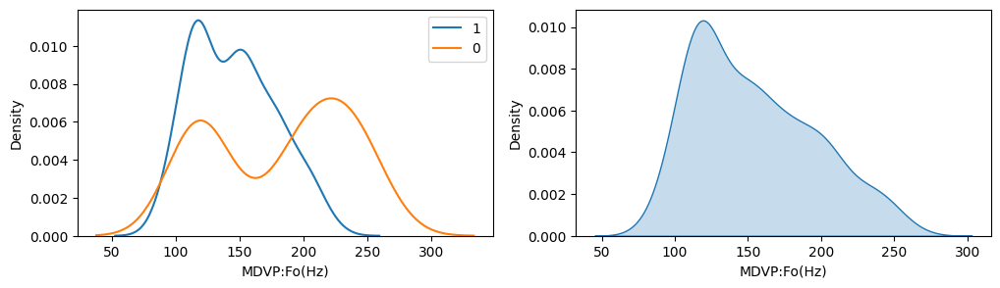

In [37]:
distributions(df,'MDVP:Fo(Hz)','status')

In [5]:
column_types = df.dtypes.apply(lambda x: str(x).split('(')[0])
data_types = column_types.to_dict()

In [6]:
dist_list = [i for i in df.columns if data_types[i] == 'float64']

In [7]:
variance_list = [i for i in df.columns if data_types[i] == 'object']
variance_list

['name']

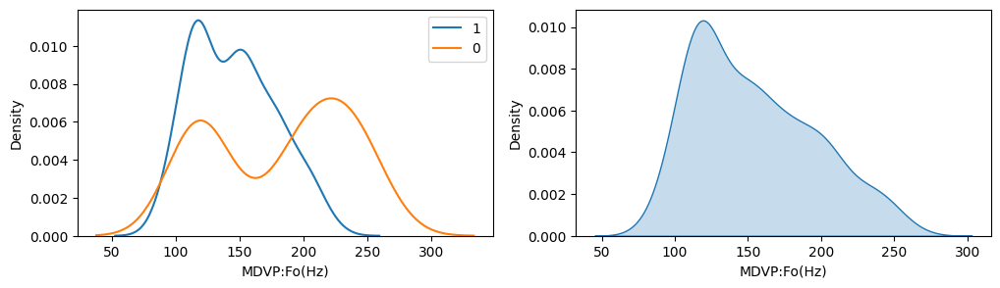

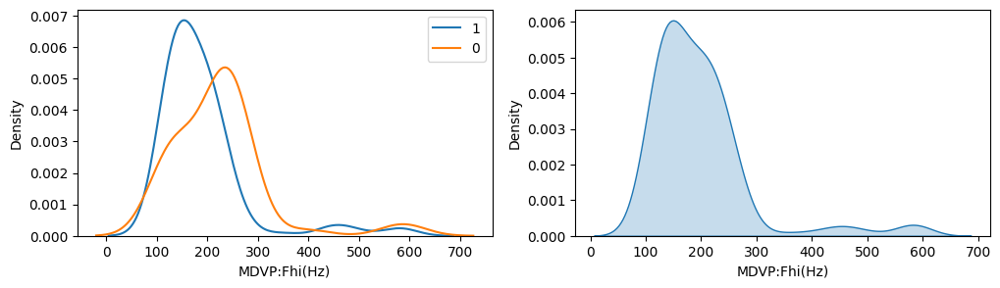

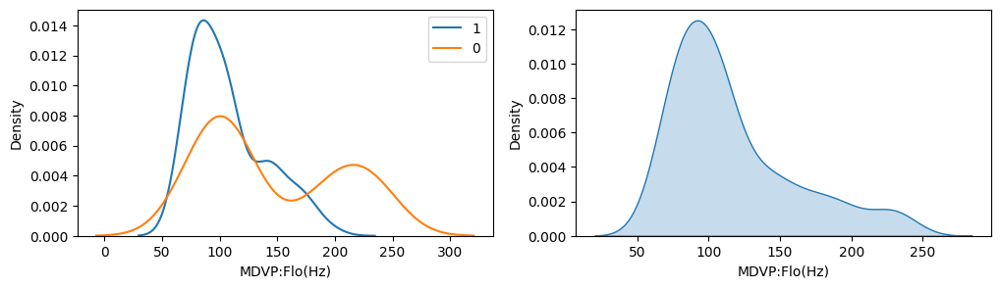

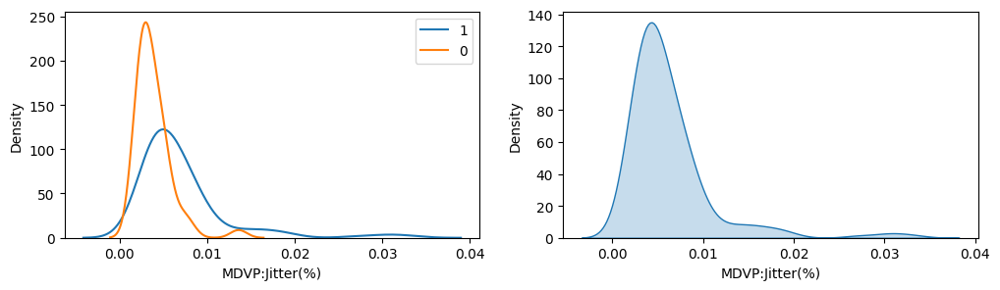

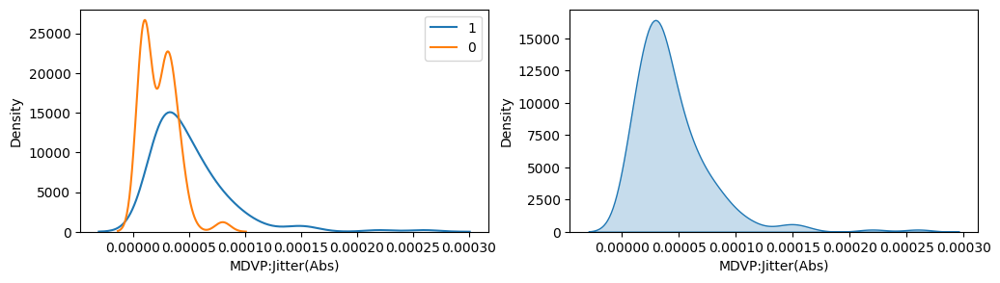

...

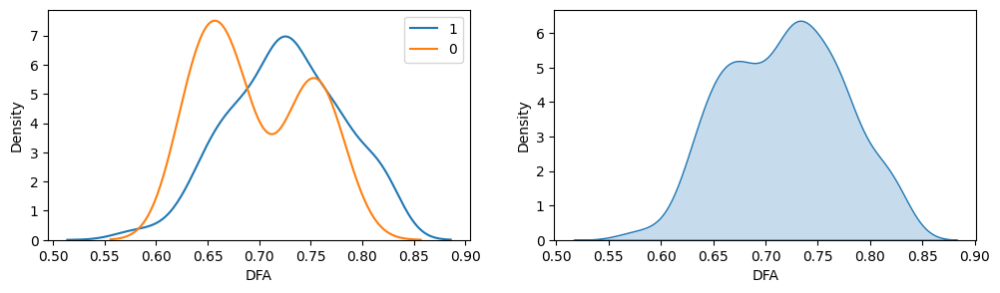

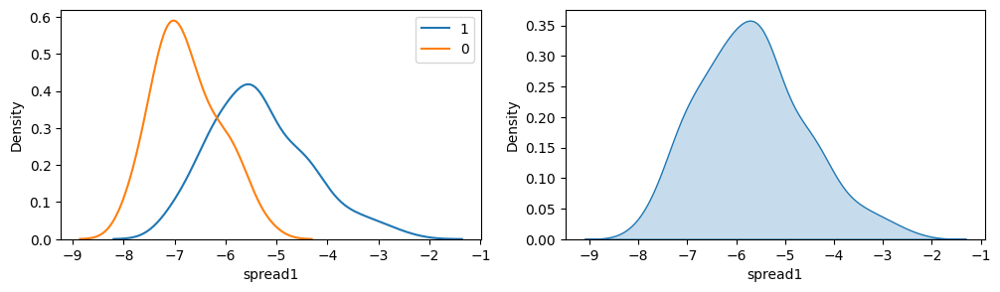

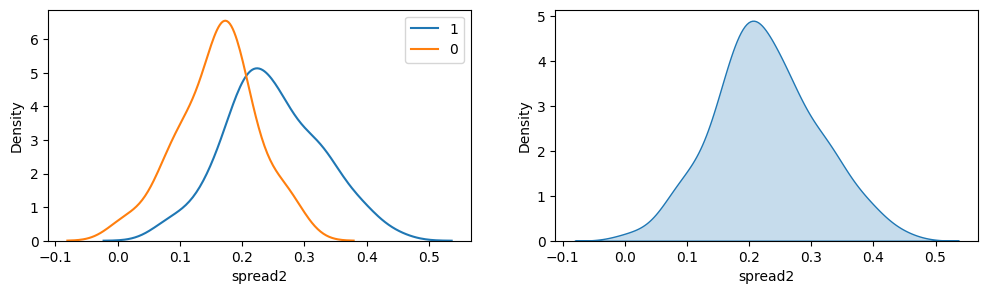

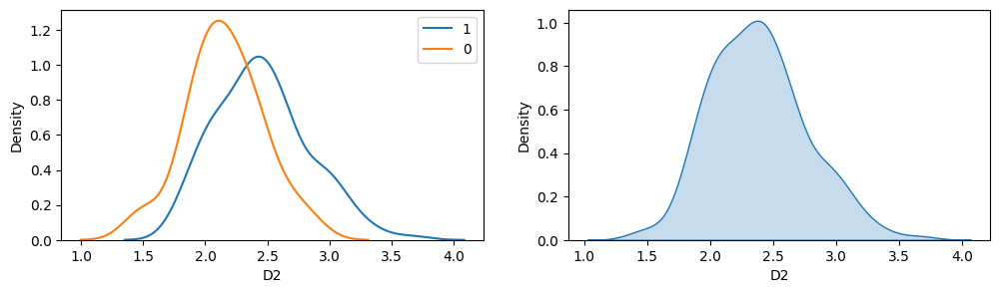

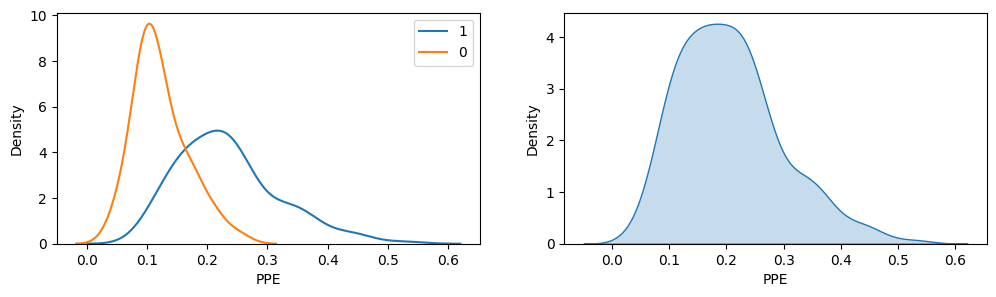

In [48]:
for feature in dist_list:
    distributions(df,feature,'status')

# Box plots for Outlier Detection

In [53]:
def box_plot(data,feature,target_variable):
    plt.figure(figsize=(6, 3))
    sns.boxplot(x = target_variable, y = feature, data = data)

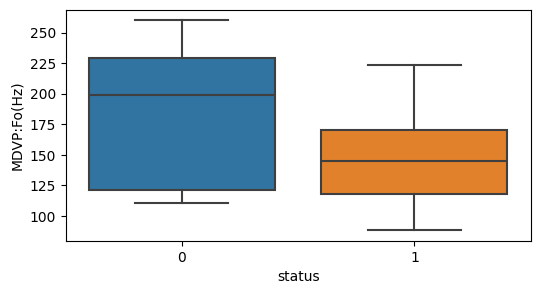

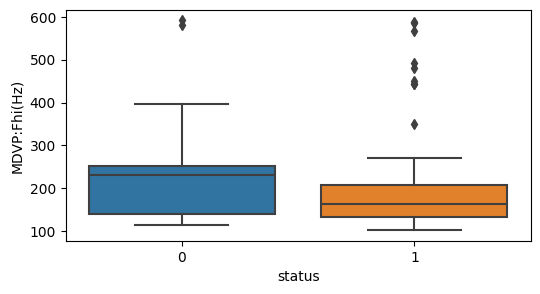

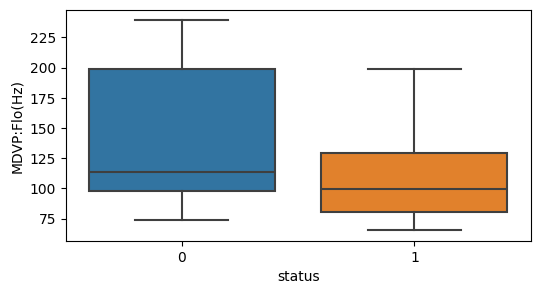

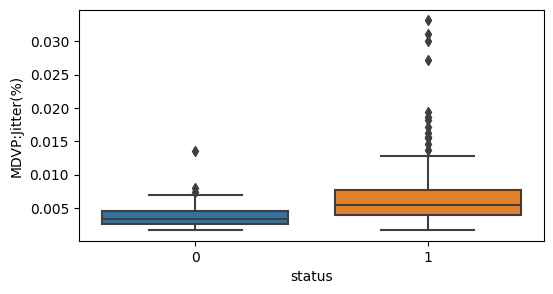

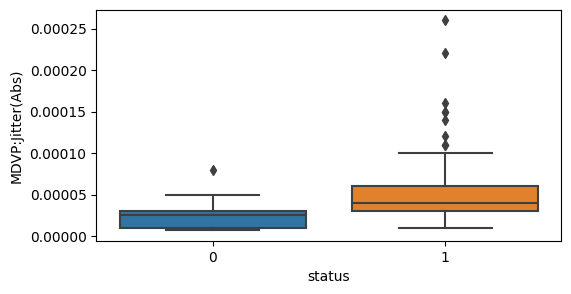

...

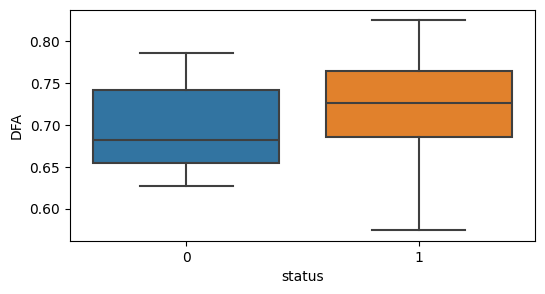

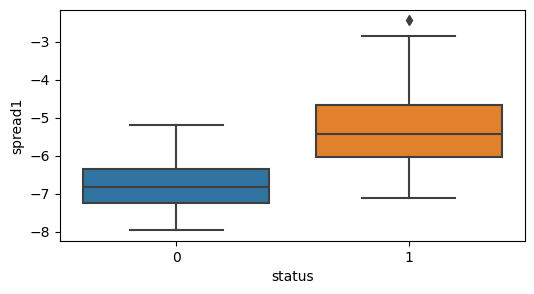

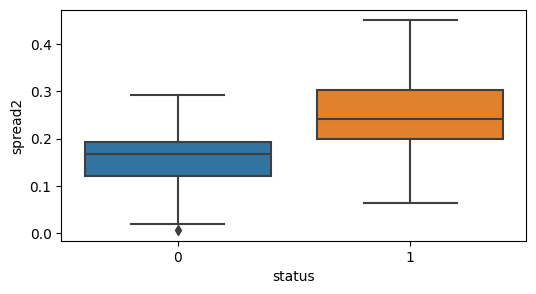

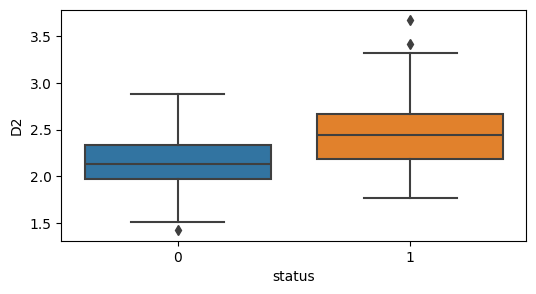

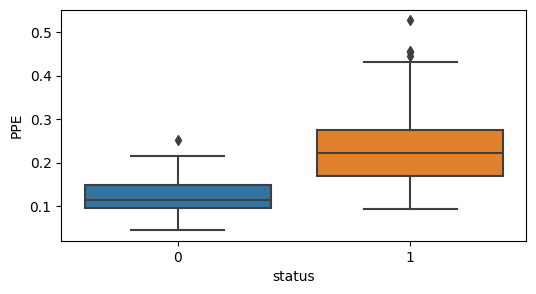

In [55]:
for feature in dist_list:
    box_plot(df,feature,'status')

# Outlier Detection

In [8]:
def outliers(data,features):
    """
    This function returns the number of outliers for a given feature
    
    """
    arr1 = data[features].values # convert feature values to an array
    q1 = np.quantile(arr1, 0.25) # get 25th percentile
    q3 = np.quantile(arr1, 0.75) # get 75th percentile
    iqr = q3-q1 # Inter Quartile Range

    upper_bound = q3+(1.5*iqr) # upper limit, value beyond this are outliers
    lower_bound = q1-(1.5*iqr) # lower limit, value below this are outliers
    
    outlier = [] # storing all the outliers
    arr = list(arr1)
    for k in arr:
        if k > upper_bound or k < lower_bound: # applying the upper & lower limit condition to get outliers
            outlier.append(k)
    
    return len(outlier)

In [9]:
dict_outlier_1 ={}
for feature in dist_list:
    dict_outlier_1[feature] = outliers(df,feature)

In [10]:
print("Number of outliers:",sum(list(dict_outlier_1.values())))

Number of outliers: 173


# Outlier Imputation

In [11]:
def replace_outlier(data,features):
    """
    This function a list of quantiles, which will be used to replace the outliers with the median value
    
    """
    arr1 = data[features].values
    q1 = np.quantile(arr1, 0.25)
    q3 = np.quantile(arr1, 0.75)
    median = np.quantile(arr1, 0.50)

    mean = sum(arr1) / len(arr1)
    counter = Counter(arr1)
    mode = counter.most_common(1)[0][0]

    iqr = q3-q1

    upper_bound = q3+(1.5*iqr)
    lower_bound = q1-(1.5*iqr)
    
    limits = [upper_bound,lower_bound,mean,median,mode]
    
    return (limits)

In [12]:
dict_replace = {}

# list contains all features which have outliers
existing_outlier = [x for x in list(dict_outlier_1.keys()) if dict_outlier_1[x] != 0] 

for feature in existing_outlier:
    dict_replace[feature] = replace_outlier(df,feature)
    
# {feature : [upper limit, lower limit, mean, median, mode]}

In [13]:
def replace_ouliers_df(data,method):
    for j in list(dict_replace.keys()):
        if method.lower() == 'mean':
            data.loc[(data[j] > dict_replace[j][0]) | (data[j] < dict_replace[j][1]), j] = dict_replace[j][2]
        elif method.lower() == 'median':
            data.loc[(data[j] > dict_replace[j][0]) | (data[j] < dict_replace[j][1]), j] = dict_replace[j][3]
        elif method.lower() == 'mode':
            data.loc[(data[j] > dict_replace[j][0]) | (data[j] < dict_replace[j][1]), j] = dict_replace[j][4]

In [14]:
d1 = df.copy()
d2 = df.copy()
d3 = df.copy()

replace_ouliers_df(d1,'mean')
replace_ouliers_df(d2,'median')
replace_ouliers_df(d3,'mode')


In [15]:
dict_outlier_final_1 ={}
for i in list(dict_replace.keys()):
    dict_outlier_final_1[i] = outliers(d1,i)

dict_outlier_final_2 ={}
for i in list(dict_replace.keys()):
    dict_outlier_final_2[i] = outliers(d2,i)

dict_outlier_final_3 ={}
for i in list(dict_replace.keys()):
    dict_outlier_final_3[i] = outliers(d3,i)

In [16]:
print("Number of outliers after mean imputation:",sum(list(dict_outlier_final_1.values())))
print("Number of outliers after median imputation:",sum(list(dict_outlier_final_2.values())))
print("Number of outliers after mode imputation:",sum(list(dict_outlier_final_3.values())))

Number of outliers after mean imputation: 89
Number of outliers after median imputation: 102
Number of outliers after mode imputation: 93


# Check variance (categorical features)

In [19]:
df_var = df.copy()
df_var = df_var[variance_list]

In [22]:
category_frequencies = df_var.apply(pd.Series.value_counts) / len(df_var)

In [24]:
# Set a threshold for low variance (e.g., 0.05)
threshold = 0.1

# Filter features with low variance
low_variance_features = category_frequencies.columns[category_frequencies.var(axis=0) < threshold]

In [25]:

# Output variance values for each feature
print("Variance for each feature:")
print(category_frequencies.var(axis=0))

Variance for each feature:
name    7.561943e-37
dtype: float64


In [27]:
# Output features with low variance
print("\nFeatures with low variance:")
print(list(low_variance_features))



Features with low variance:
['name']
